In [2]:
# Load libraries
import numpy as np
import pandas as pd
pd.set_option('display.max_columns', None)

import matplotlib.pyplot as plt
from matplotlib.ticker import FormatStrFormatter
from pylab import rcParams
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 72

import seaborn as sns
sns.set_style("darkgrid")
sns.set_context(context="paper", font_scale=1.5, rc=None)
sns.set(font="serif")

#import plotly.express as px
#import plotly.graph_objects as go

import geopandas as gpd

from sklearn import preprocessing
from sklearn.preprocessing import OrdinalEncoder


import libpysal as ps
from libpysal  import weights
from libpysal.weights import Queen

import esda
from esda.moran import Moran, Moran_Local

import splot
from splot.esda import moran_scatterplot, plot_moran, lisa_cluster, plot_local_autocorrelation
from splot.libpysal import plot_spatial_weights

from giddy.directional import Rose

import statsmodels.api as sm
import statsmodels.formula.api as smf
#from stargazer.stargazer import Stargazer, LineLocation

from spreg import OLS
from spreg import MoranRes
from spreg import ML_Lag
from spreg import ML_Error 

from mgwr.gwr import GWR, MGWR
from mgwr.sel_bw import Sel_BW
from mgwr.utils import shift_colormap, truncate_colormap

import warnings
warnings.filterwarnings('ignore') 
import time

# IMPORT DATA

In [3]:
# Load  dataset 
gdf  = gpd.read_file('data/nb_df.gpkg')

#Filtering bools
bools= gdf.select_dtypes(include=['bool'])

enc = OrdinalEncoder()
bools_encoded = enc.fit_transform(bools)
bools_encoded = pd.DataFrame(bools_encoded, columns = bools.columns)

#removing old bools
gdf = gdf.drop(bools.columns, axis = 1)
gdf = gdf.reset_index(drop = True)

# Select variables (y, X) and define coordinates

In [4]:
y = gdf['price_small'].values.reshape((-1,1)) # reshape is needed to have column array

In [5]:
X_df =gdf.drop(['id_right', 'age', 'price_small', 'construction_size', 'geometry', 'price_per_area_small', 'latitude', 'longitude', 'price', 'price_per_area'], axis = 1)
X = X_df.values

#Scaling the standarized data
min_max_scaler = preprocessing.MinMaxScaler()
X= min_max_scaler.fit_transform(X)

In [6]:
#Getting polygons centroids
gdf["centroids"] = gdf["geometry"].centroid
u =  gdf["centroids"].x
v =  gdf["centroids"].y
coords = list(zip(u,v))

## Estimate GWR model
### Select GWR bandwith

In [7]:
%%time
gwr_selector = Sel_BW(coords, y, X, kernel="gaussian")
gwr_bw = gwr_selector.search(criterion='AIC')

CPU times: total: 13.4 s
Wall time: 5.57 s


In [8]:
print('GWR bandwidth =', gwr_bw)

GWR bandwidth = 115.0


# Fit GWR model

In [9]:
gwr_results = GWR(coords, y, X, gwr_bw, kernel='gaussian').fit()
gwr_results.summary()

Model type                                                         Gaussian
Number of observations:                                                 699
Number of covariates:                                                    37

Global Regression Results
---------------------------------------------------------------------------
Residual sum of squares:                                           4479.069
Log-likelihood:                                                   -1641.041
AIC:                                                               3356.082
AICc:                                                              3362.573
BIC:                                                                143.200
R2:                                                                   0.602
Adj. R2:                                                              0.580

Variable                              Est.         SE  t(Est/SE)    p-value
------------------------------- ---------- ---------- ------

In [10]:
# As reference, here is the (average) R2, AIC, and AICc
print('Mean R2 =', gwr_results.R2)
print('AIC =', gwr_results.aic)
print('AICc =', gwr_results.aicc)

Mean R2 = 0.7315491128776425
AIC = 3222.6597113193598
AICc = 3262.481031821174


In [11]:
#Copy to preserve original gdf
gdf_r = gdf.copy()
# Add R2 to GeoDataframe 
gdf_r['gwr_R2'] = gwr_results.localR2

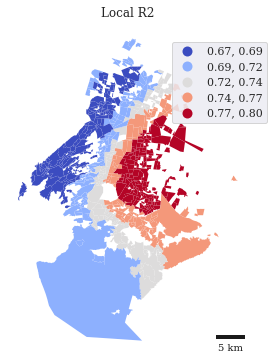

In [13]:
import matplotlib.pyplot as plt
from matplotlib_scalebar.scalebar import ScaleBar

fig, ax = plt.subplots(figsize=(6, 6))
gdf_r.plot(column='gwr_R2', cmap='coolwarm', linewidth=0.01, scheme='FisherJenks', k=5, legend=True, legend_kwds={'bbox_to_anchor':(1.10, 0.96)}, ax=ax)
ax.set_title('Local R2', fontsize=12)
ax.axis('off')

scalebar = ScaleBar(1, location='lower right', box_alpha=0.7, font_properties={'size': 10})
ax.add_artist(scalebar)

plt.show()

# Plot Residuals

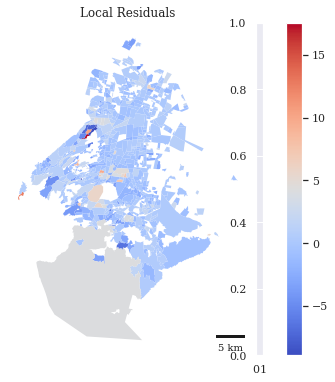

In [14]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib_scalebar.scalebar import ScaleBar
import matplotlib.colors as colors

gdf_r['res'] = gwr_results.resid_response
fig, ax = plt.subplots(figsize=(6, 6))
cmap = plt.cm.get_cmap('coolwarm')
vmin = gdf_r['res'].min()
vmax = gdf_r['res'].max()
norm = colors.Normalize(vmin=vmin, vmax=vmax)
gdf_r.plot(column='res', cmap=cmap, linewidth=0.01, legend=True, norm=norm, ax=ax)
ax.set_title('Local Residuals', fontsize=12)
ax.axis("off")
scalebar = ScaleBar(1, location='lower right', box_alpha=0.7, font_properties={'size': 10})
ax.add_artist(scalebar)

divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="3%", pad=0.1)

plt.show()

<AxesSubplot: xlabel='res', ylabel='Count'>

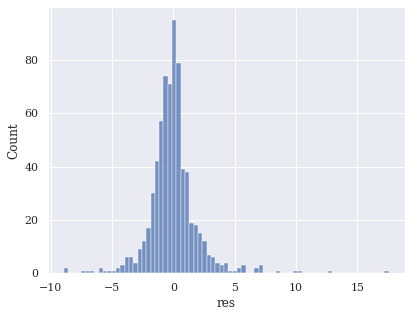

In [15]:
#plot distribution
import seaborn as sns
sns.histplot(data=gdf_r, x="res")

# Plot coefficients GLOBAL

In [16]:
#Store coef column names
coef_names = []

for num,column in enumerate (X_df.columns):
    gdf_r['gwr_{}'.format(column)] = gwr_results.params[:,num+1] 
    coef_names.append('gwr_{}'.format(column))

# Coef average absolute

In [17]:
#creating copy()gdf_abs =gdf_r.copy()
gdf_abs =gdf_r.copy()

#acum per coeficient
mean_coef= []

#getting abs of each var
for num,column in enumerate ('gwr_'+X_df.columns):
    gdf_abs[column] = gdf_abs[column].apply(lambda x : abs(x))
    mean_coef.append(gdf_abs[column].mean())

df = pd.DataFrame(mean_coef).T
df.columns= X_df.columns
df = df.T.reset_index().rename(columns={'index': 'variable', 0: "coef_abs_value"})
df_coefs_abs = df.sort_values(by= "coef_abs_value" )
df_coefs_abs.to_csv("coef_abs_gwr.csv", index = False)


## MGWR

In [ ]:
mgwr_selector = Sel_BW(coords, y, X, multi=True, kernel='gaussian')
mgwr_bw = mgwr_selector.search(criterion='AIC')

In [64]:
mgwr_results = MGWR(coords, y, X, mgwr_selector, kernel='gaussian').fit()
mgwr_results.summary()

Inference:   0%|          | 0/1 [00:00<?, ?it/s]

Model type                                                         Gaussian
Number of observations:                                                 699
Number of covariates:                                                    37

Global Regression Results
---------------------------------------------------------------------------
Residual sum of squares:                                           4451.154
Log-likelihood:                                                   -1638.856
AIC:                                                               3351.712
AICc:                                                              3358.203
BIC:                                                                115.285
R2:                                                                   0.605
Adj. R2:                                                              0.583

Variable                              Est.         SE  t(Est/SE)    p-value
------------------------------- ---------- ---------- ------

In [65]:
# As reference, here is the (average) R2, AIC, and AICc
print('Mean R2 =', mgwr_results.R2)
print('AIC =', mgwr_results.aic)
print('AICc =', mgwr_results.aicc)

Mean R2 = 0.7433929020383614
AIC = 3115.614543441226
AICc = 3131.5105431729926


# Show bandwidth intervals

In [67]:
#Copy to preserve original gdf
gdf_mr = gdf.copy()

# Local R2 are NOT yet implemented in MGWR
#mgwr_results.localR2[0:5]

# Plot Residuals

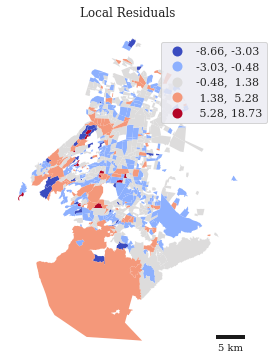

In [68]:
gdf_mr['res'] = mgwr_results.resid_response
fig, ax = plt.subplots(figsize=(6, 6))
gdf_mr.plot(column='res', cmap = 'coolwarm', linewidth=0.01, scheme = 'FisherJenks', k=5, legend=True, legend_kwds={'bbox_to_anchor':(1.10, 0.96)},  ax=ax)
ax.set_title('Local Residuals', fontsize=12)
ax.axis("off")
#plt.savefig('myMap.png',dpi=150, bbox_inches='tight')
scalebar = ScaleBar(1, location='lower right', box_alpha=0.7, font_properties={'size': 10})
ax.add_artist(scalebar)

plt.show()

<AxesSubplot: xlabel='res', ylabel='Count'>

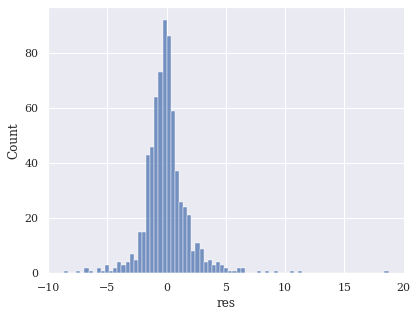

In [69]:
#plot distribution
import seaborn as sns
sns.histplot(data=gdf_mr, x="res")

# Plot coefficients GLOBAL

In [70]:
#Store coef column names
coef_names = []

for num,column in enumerate (X_df.columns):
    gdf_mr['gwr_{}'.format(column)] = mgwr_results.params[:,num+1]
    coef_names.append('gwr_{}'.format(column))


,bedrooms,bathrooms,half_bathrooms,lot_size,construction_size,age,is_house,real_age,latitude,longitude,balcony,water strorage,air_conditioning,pool,furniture,accasible_for_handicap,first_floor,security,parking_space,kitchen,garden,roof_Garden,service_room,gated_community,price_per_area,price_per_area_small,high_impact/area,low_impact/area,parks,schools,university,hospital,sport_facility,supermarket,mall,stadium,historic,museum,airport,industry,subway,bus,id_right,price,price_small,geometry,centroids,res,gwr_bedrooms,gwr_bathrooms,gwr_half_bathrooms,gwr_lot_size,gwr_is_house,gwr_real_age,gwr_balcony,gwr_water strorage,gwr_air_conditioning,gwr_pool,gwr_furniture,gwr_accasible_for_handicap,gwr_first_floor,gwr_security,gwr_parking_space,gwr_kitchen,gwr_garden,gwr_roof_Garden,gwr_service_room,gwr_gated_community,gwr_high_impact/area,gwr_low_impact/area,gwr_parks,gwr_schools,gwr_university,gwr_hospital,gwr_sport_facility,gwr_supermarket,gwr_mall,gwr_stadium,gwr_historic,gwr_museum,gwr_airport,gwr_industry,gwr_subway,gwr_bus
0,1.607506,3.795655,-0.782058,-0.090367,0.101543,0.274983,1.189032,2.965947,1.189645,-0.527365,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,1.583125,-0.256962,-0.37789,-0.483958,-0.041937,-0.686690,-0.686690,-0.362235,-0.490653,-1.204725,-0.026416,-0.190933,0.217603,-0.937668,-0.393369,-0.428634,0.059922,-0.030999,0.142419,-0.086261,-0.280822,-0.360175,-0.457558,8,3400000.0,3.4000,"MULTIPOLYGON (((2793299.849 832180.730, 279330...",POINT (2793471.544 832294.395),-4.093855,-3.820705,8.209239,21.765846,33.740222,-1.532007,-0.789502,0.355744,-0.216109,2.636711,0.118416,-0.257722,-0.160736,2.108294,0.041690,-0.286736,0.016856,-0.108750,0.795252,-0.078957,-0.412212,-3.558356,1.180592,-1.110475,1.047795,-0.207029,0.030967,-0.337496,-0.376696,-2.526685,-0.912032,-0.667024,-2.730806,2.123385,7.502621,-2.541529,-1.166609
1,-0.789660,-1.259302,-0.782058,-0.164097,-0.170815,-0.151405,-0.912587,0.167806,0.928072,-0.362927,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,1.583125,-0.256962,-0.37789,-0.483958,-0.041937,0.468556,0.468556,1.776640,1.564577,-1.733903,0.478983,-0.620477,0.066453,-1.146581,-0.490887,-0.834471,0.076028,-0.273689,-0.313227,-0.352554,-0.992470,-0.777304,-0.857703,16,2539500.0,2.5395,"MULTIPOLYGON (((2794357.004 830240.705, 279438...",POINT (2794483.270 830330.304),0.174632,-3.819556,10.159057,26.360601,31.467555,-0.067571,-0.788091,0.351431,-0.216012,2.676330,0.116205,-0.251113,-0.165538,2.108294,0.042452,-0.288776,0.024435,-0.106341,0.795833,-0.054597,-0.411771,-3.559843,1.170225,-1.112670,1.055573,-0.208364,0.028083,-0.338003,-0.384538,-2.527654,-0.913828,-0.668924,-2.778364,2.122766,7.728018,-2.543066,-1.169085
2,-1.588716,-1.259302,-0.782058,-0.141148,-0.147499,-0.342970,-0.912587,-1.089330,0.628836,-0.654206,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,-1.299618,-0.256962,-0.37789,-0.483958,-0.041937,2.725285,2.725285,0.106282,1.299354,0.423617,2.150015,-0.493853,-1.058884,-0.739339,-0.711208,-0.331797,0.405543,-0.918067,-0.833031,-0.101611,0.366546,-0.586630,0.407494,33,6950000.0,6.9500,"MULTIPOLYGON (((2792835.890 828193.326, 279284...",POINT (2792847.230 827937.598),1.837461,-3.817511,10.625324,19.025260,22.997655,3.811676,-0.785415,0.344069,-0.215238,2.673781,0.119439,0.040957,-0.168290,2.108294,0.049244,-0.296095,0.041541,-0.099402,0.795505,-0.131794,-0.415535,-3.565749,1.063377,-1.116621,1.080070,-0.206712,0.026585,-0.336468,-0.380716,-2.531256,-0.911282,-0.667586,-1.142486,2.122353,7.849862,-2.542798,-1.178754
3,5.602784,1.773672,-0.782058,-0.071812,0.169013,-0.342970,1.189032,-1.089330,0.492163,0.801185,-0.280675,-0.319698,-0.078457,-0.178423,-0.060755,-0.124474,-0.037796,-0.292728,-0.30405,1.583125,-0.256962,-0.37789,-0.483958,-0.041937,0.409655,0.409655,-0.181528,0.331494,-0.788814,-0.642095,1.123594,0.069091,-0.167126,-0.450806,-0.580005,-0.407965,-0.400672,-0

# Coef mean value

In [ ]:
#creating copy()
gdf_abs_m =gdf_mr.copy()

#acum per coeficient
mean_coef= []

#getting abs of each var
for num,column in enumerate ('gwr_'+X_df.columns):
    gdf_abs_m[column] = gdf_abs_m[column].apply(lambda x : abs(x))
    mean_coef.append(gdf_abs_m[column].mean())

df = pd.DataFrame(mean_coef).T
df.columns= X_df.columns
df = df.T.reset_index().rename(columns={'index': 'variable', 0: "coef_abs_value"})
df_coefs_m = df.sort_values(by= "coef_abs_value" )
df_coefs_m.to_csv("coef_abs_mgwr.csv", index = False)

In [ ]:
#Store coef column names
coef_names = []

for num,column in enumerate (X_df.columns):
    gdf_mr['gwr_{}'.format(column)] = mgwr_results.params[:,num+1]
    coef_names.append('gwr_{}'.format(column))
    

# Plotting both gwr and mgwr


# Results

In [77]:
print('For GWR:')
print('Mean R2 =', gwr_results.R2)
print('AIC =', gwr_results.aic)
print('AICc =', gwr_results.aicc)

print("")
print('For MGWR:')
print('Mean R2 =', mgwr_results.R2)
print('AIC =', mgwr_results.aic)
print('AICc =', mgwr_results.aicc)

For GWR:
Mean R2 = 0.732583390492922
AIC = 3219.483330300514
AICc = 3259.113147749645

For MGWR:
Mean R2 = 0.7433929020383614
AIC = 3115.614543441226
AICc = 3131.5105431729926


# Local coefs both methods


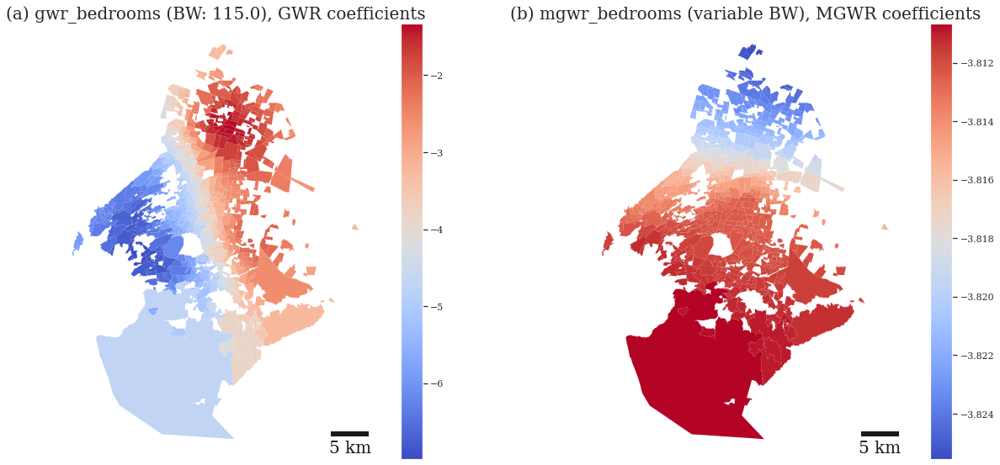

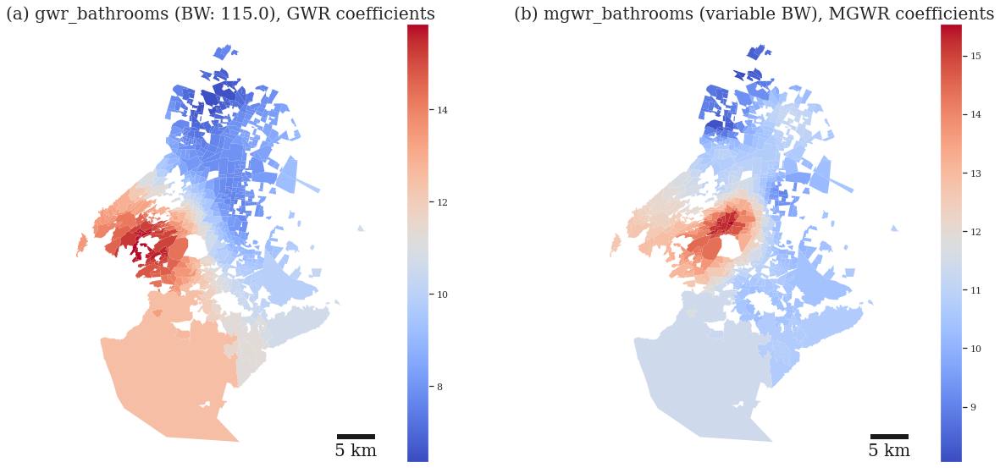

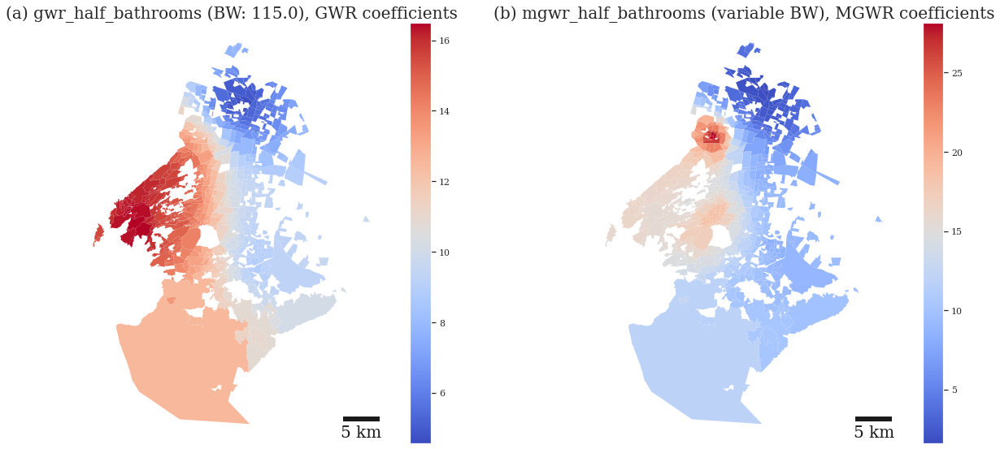

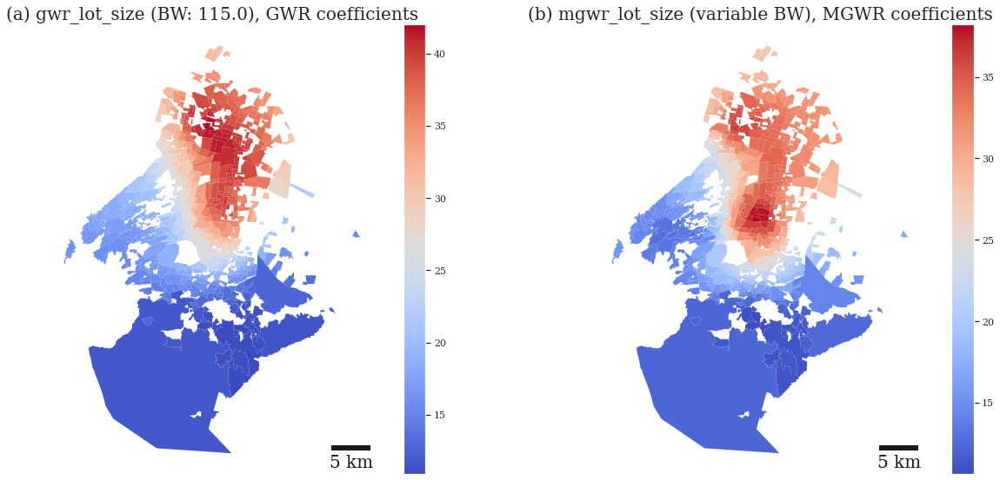

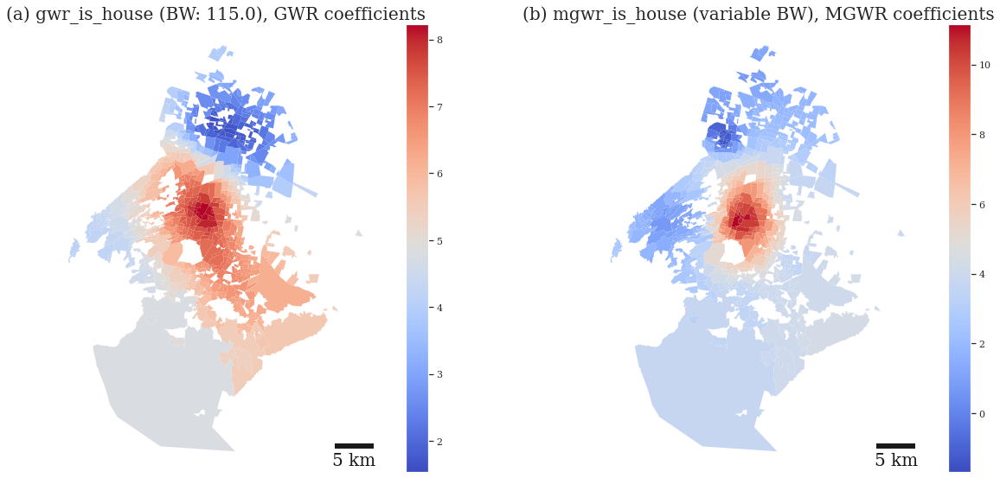

...

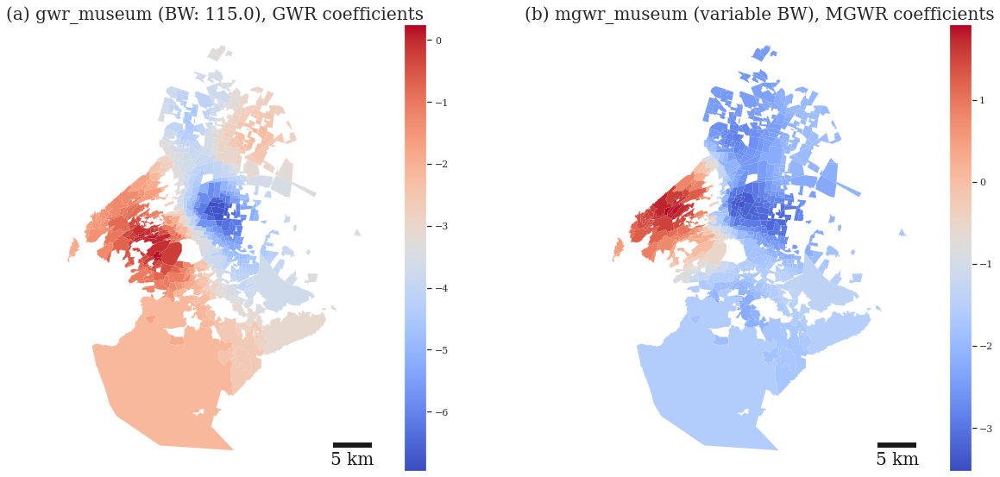

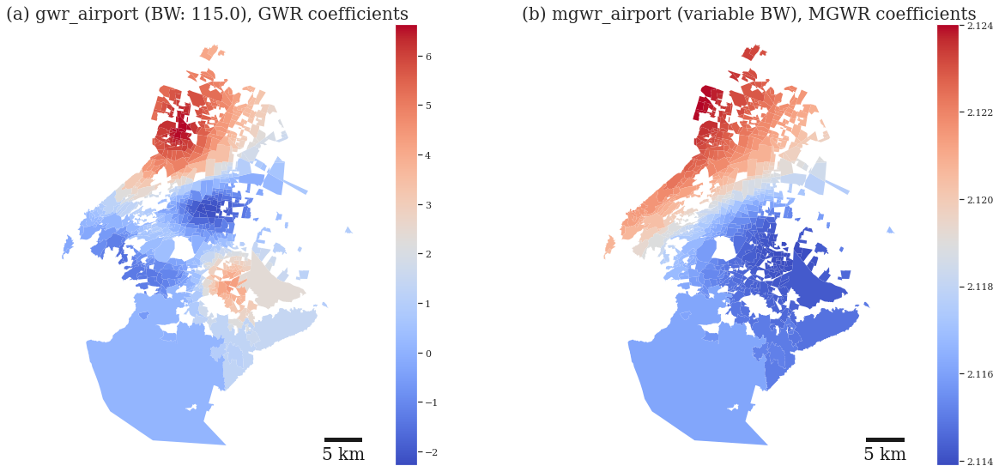

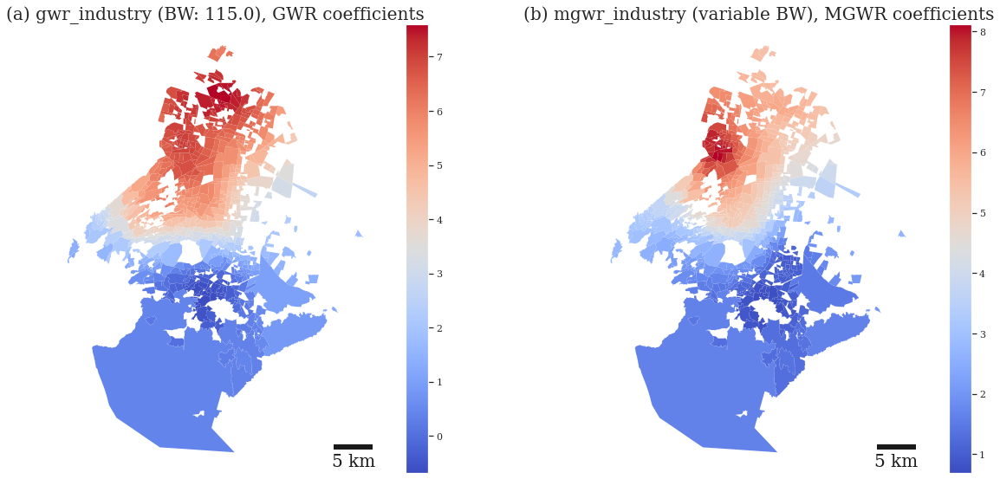

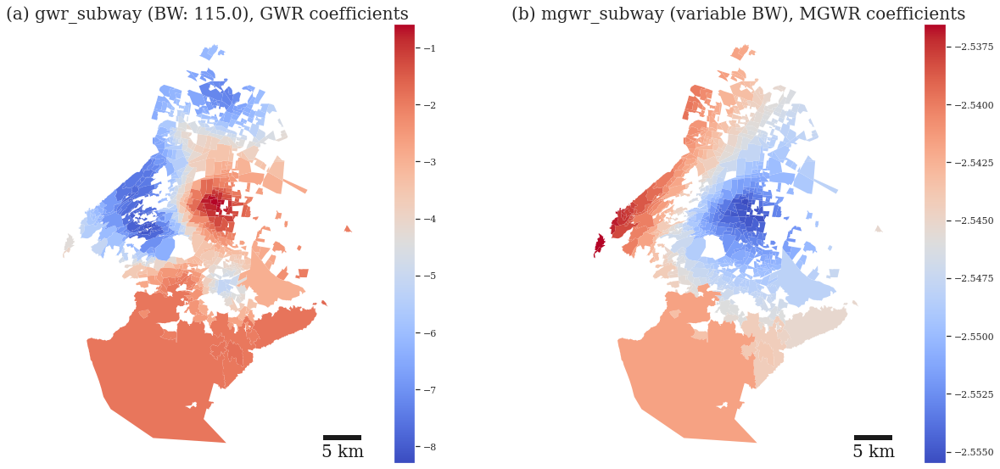

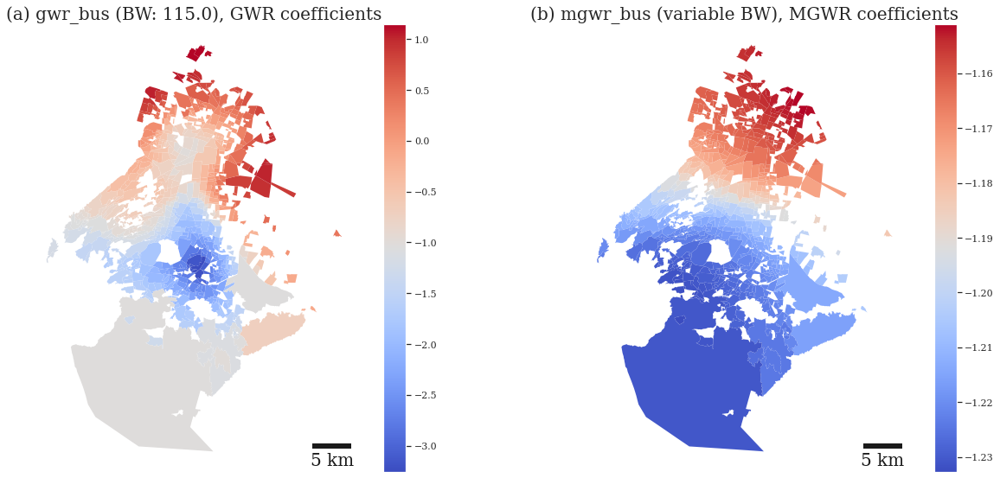

In [95]:
for num,col in enumerate (coef_names):

    try:
        fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(18,8))
        
        cmap = plt.cm.get_cmap('coolwarm')
        vmin = gdf_r[col].min()
        vmax = gdf_r[col].max()
        norm = colors.Normalize(vmin=vmin, vmax=vmax)
       
        #Plotting gwr
        gdf_r.plot(column= col, cmap=cmap, linewidth=0.01, legend=True, norm=norm, ax=axes[0])
        
        vmin = gdf_mr[col].min()
        vmax = gdf_mr[col].max()
        norm = colors.Normalize(vmin=vmin, vmax=vmax)
    
        #Plotting mgwr
        gdf_mr.plot(column= col, cmap=cmap, linewidth=0.01, legend=True, norm=norm, ax=axes[1])
        plt.tight_layout()

        axes[0].axis("off")
        axes[1].axis("off")


        axes[0].set_title('(a) '+col +' (BW: ' + str(gwr_bw) +'), GWR coefficients',     fontsize=20)
        axes[1].set_title('(b) m'+ col+' (variable BW), MGWR coefficients',     fontsize=20)
        
        
        #Adding scalebar
        scalebar1 = ScaleBar(1, location='lower right', box_alpha=0.7, font_properties={'size': 20})
        axes[0].add_artist(scalebar1)

        scalebar2 = ScaleBar(1, location='lower right', box_alpha=0.7, font_properties={'size': 20})
        axes[1].add_artist(scalebar2)

        plt.show()
        #fig.savefig("img/"+col+'2_images.png', dpi=300)
    except:
        pass

Plots below were in the poster

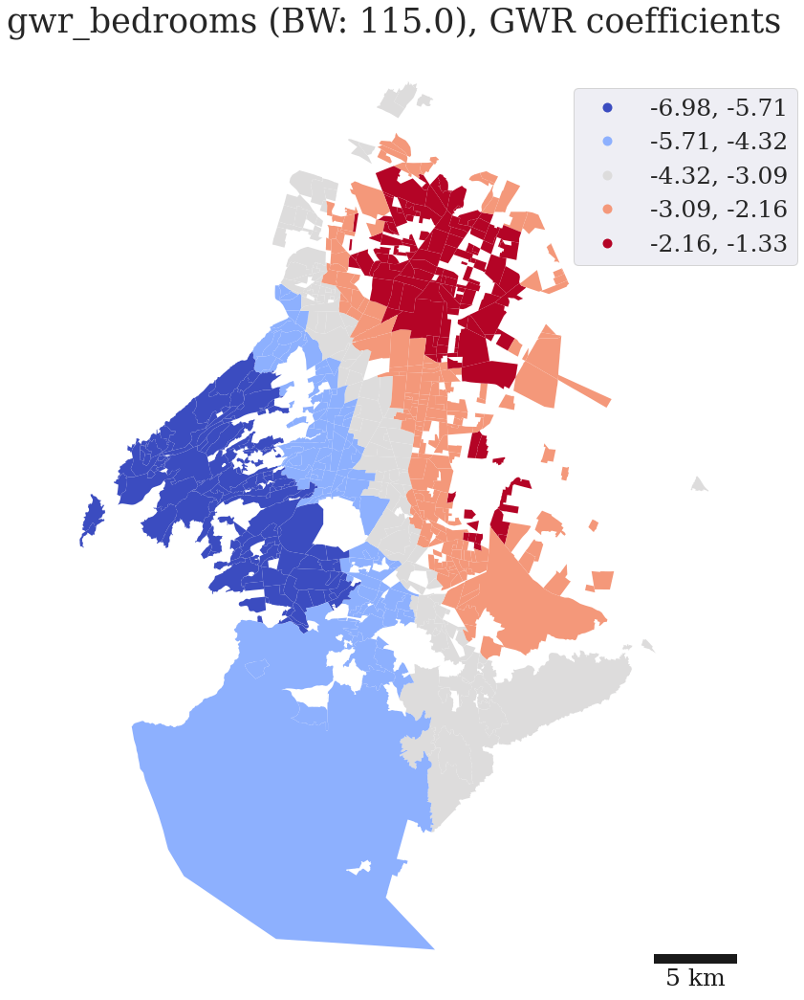

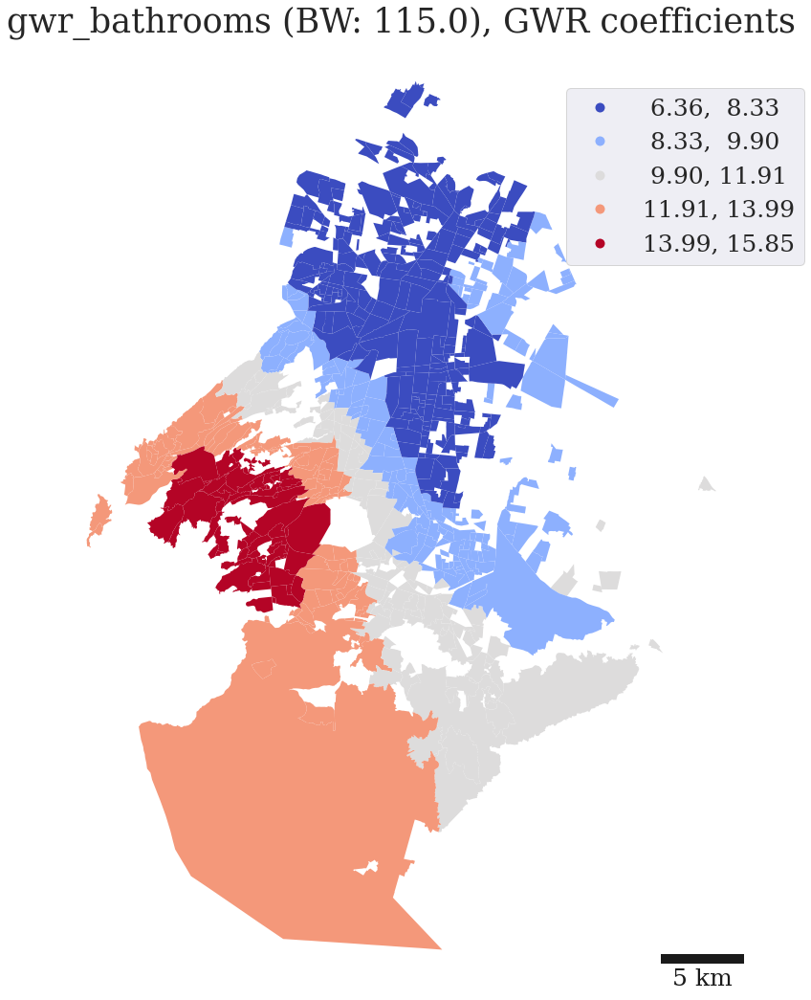

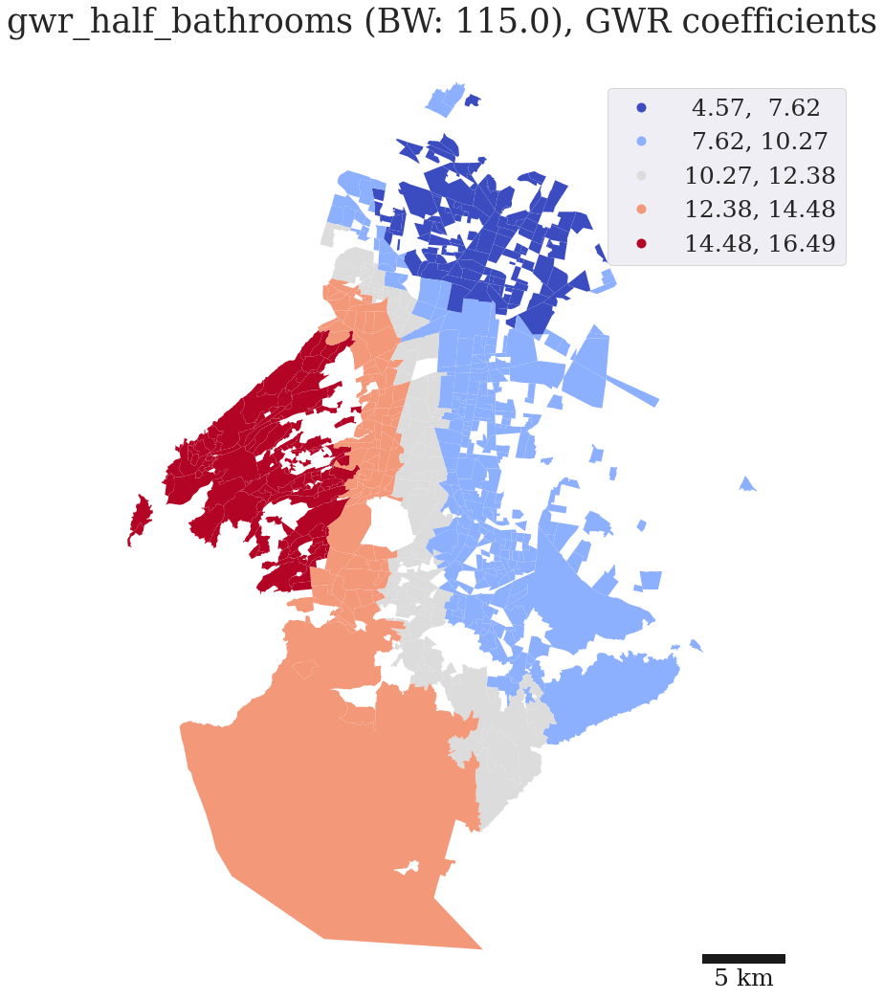

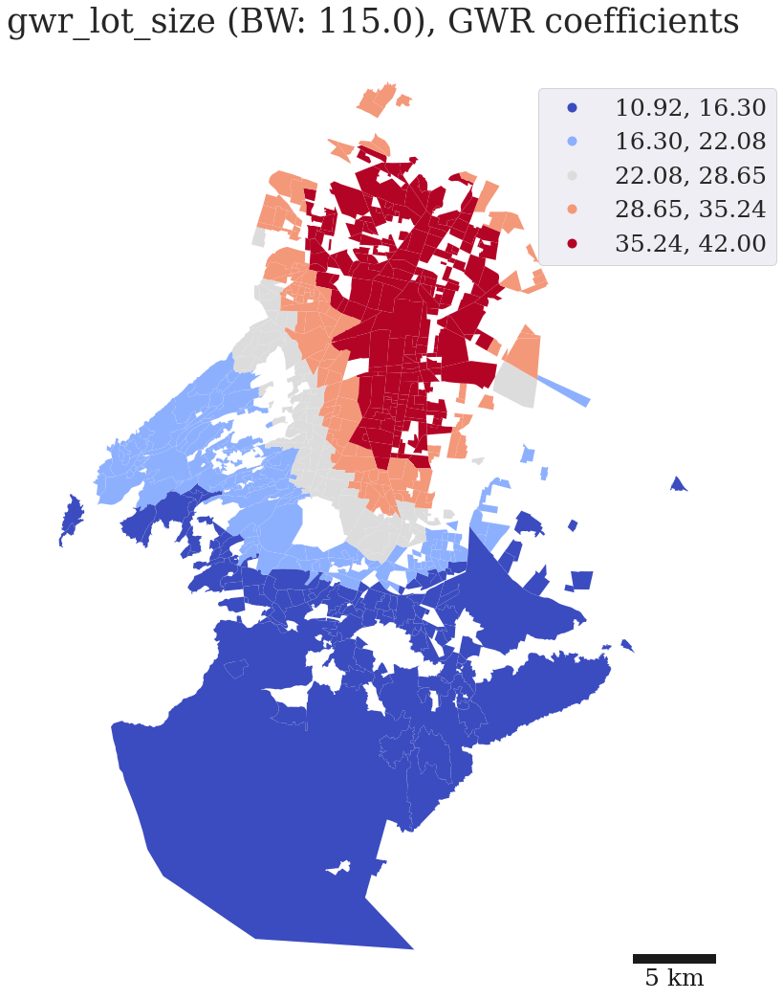

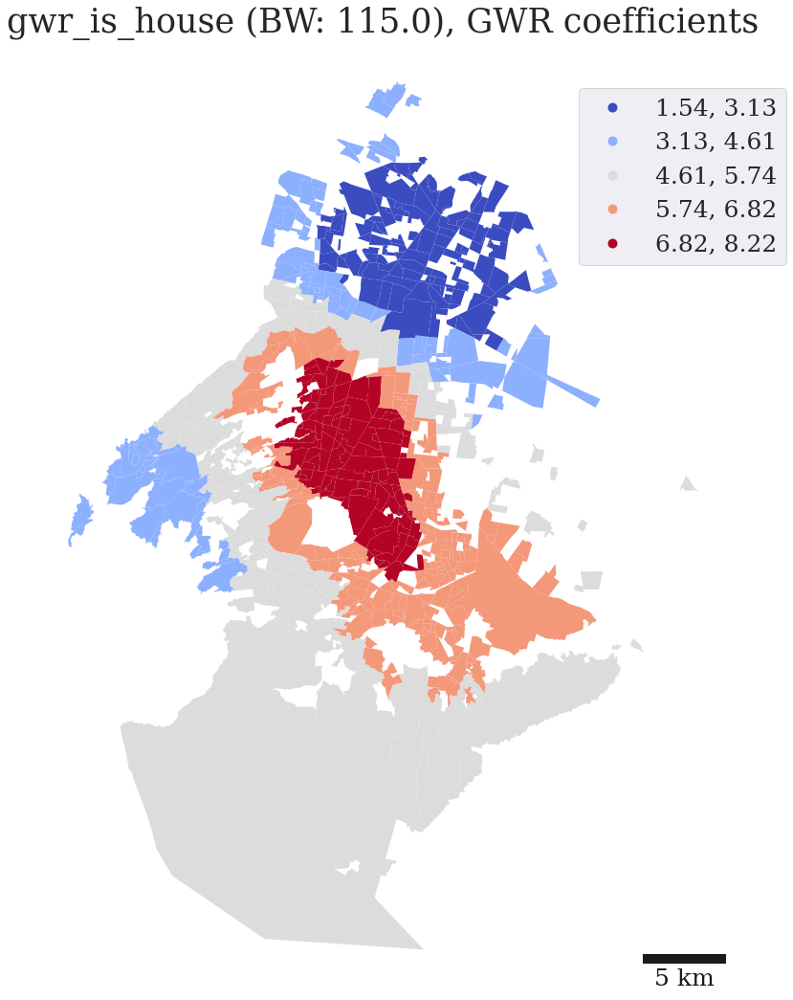

...

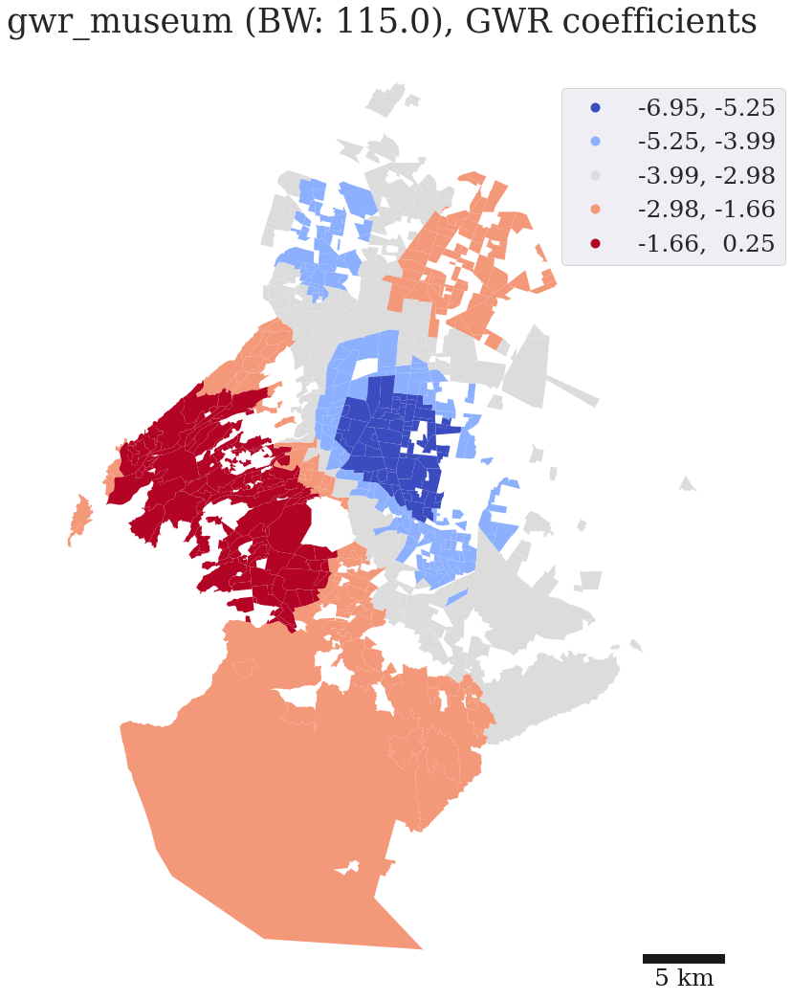

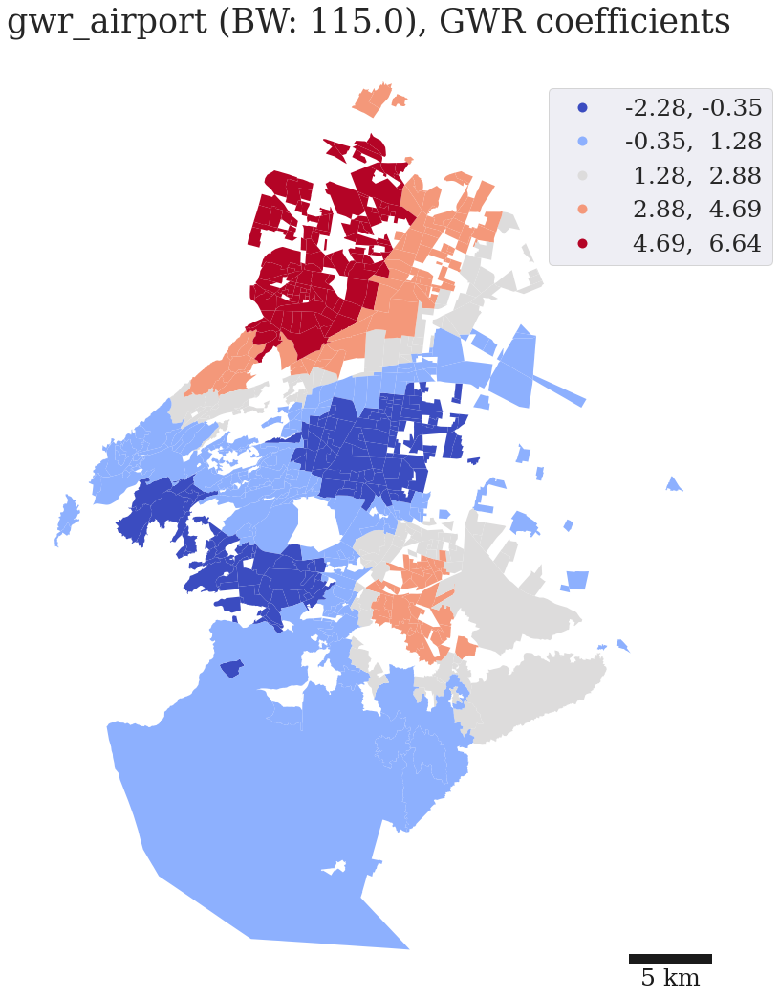

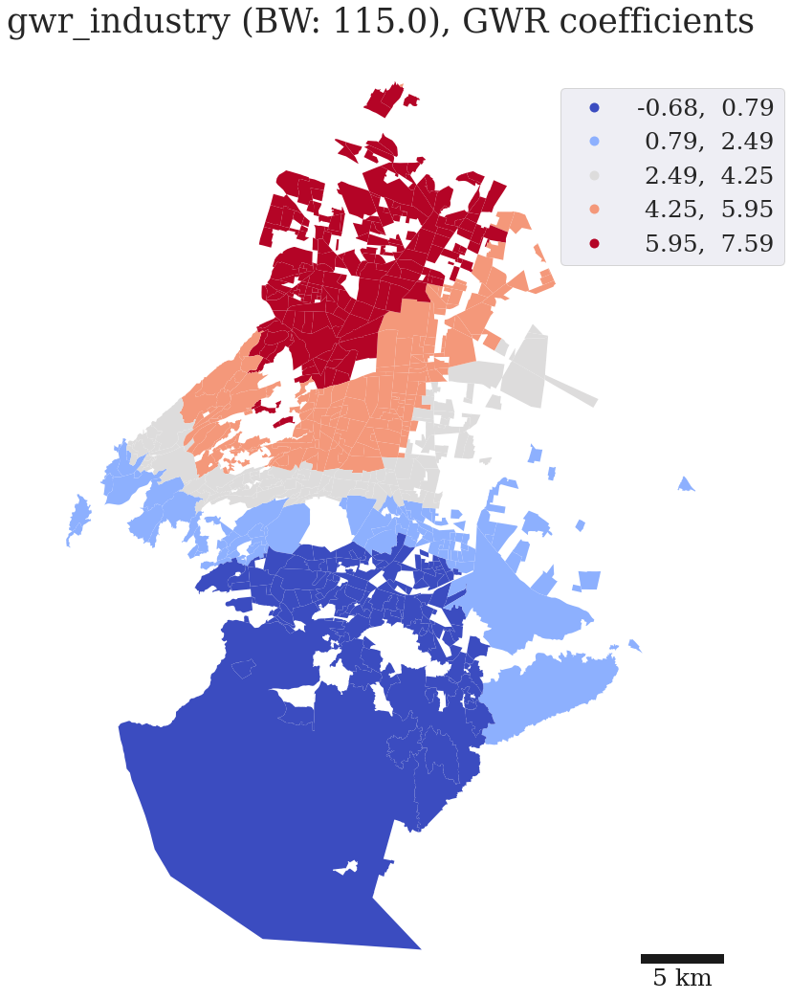

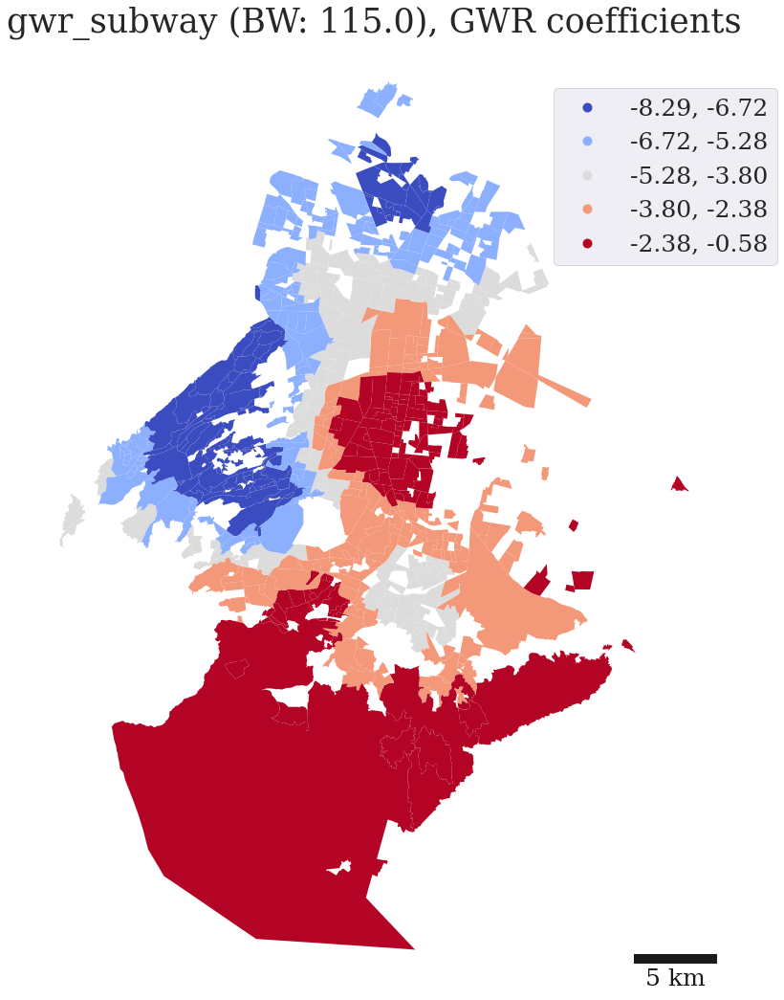

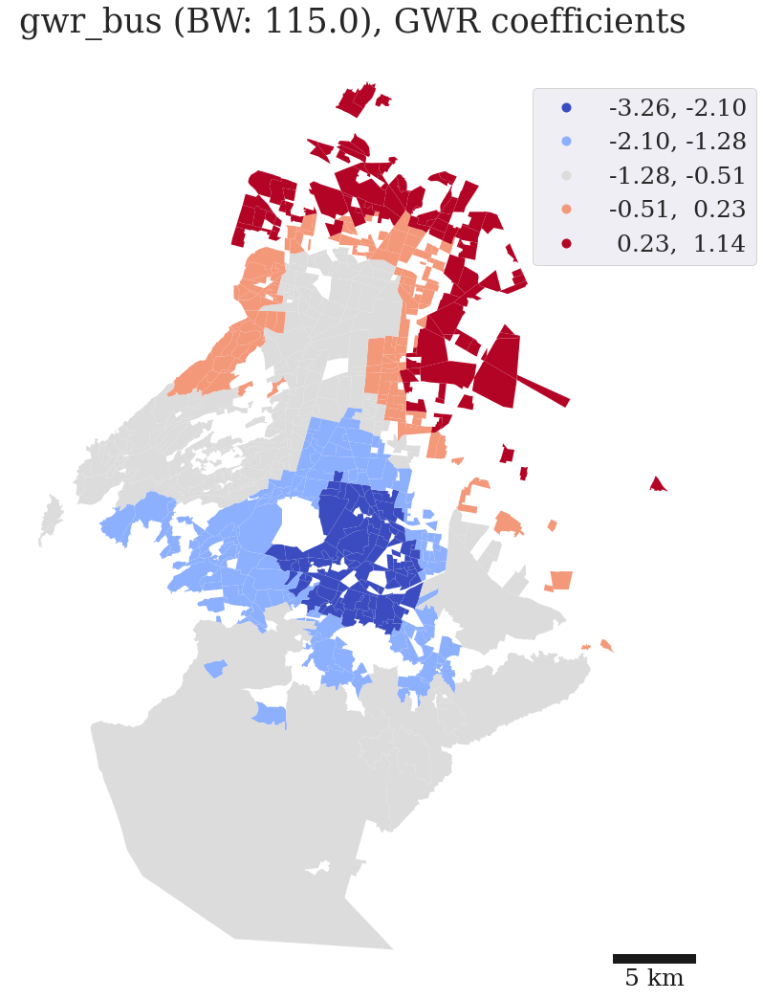

In [93]:
for num,col in enumerate (coef_names):

    try:
       
        fig, ax = plt.subplots(figsize=(18, 18))
        gdf_r.plot(column=col, cmap = 'coolwarm', linewidth=0.01, scheme = 'FisherJenks', k=5, legend=True, legend_kwds={'bbox_to_anchor':(1.10, 0.96), 'fontsize': 25},  ax=ax)
        ax.set_title(col +' (BW: ' + str(gwr_bw) +'), GWR coefficients',     fontsize=35)
        ax.axis("off")
        #plt.savefig('myMap.png',dpi=150, bbox_inches='tight')
        scalebar = ScaleBar(1, location='lower right', box_alpha=0.7, font_properties={'size': 25})
        ax.add_artist(scalebar)

        
        plt.show()
        #fig.savefig("img/" + col+' GWR.png', dpi=300)
    except:
        pass

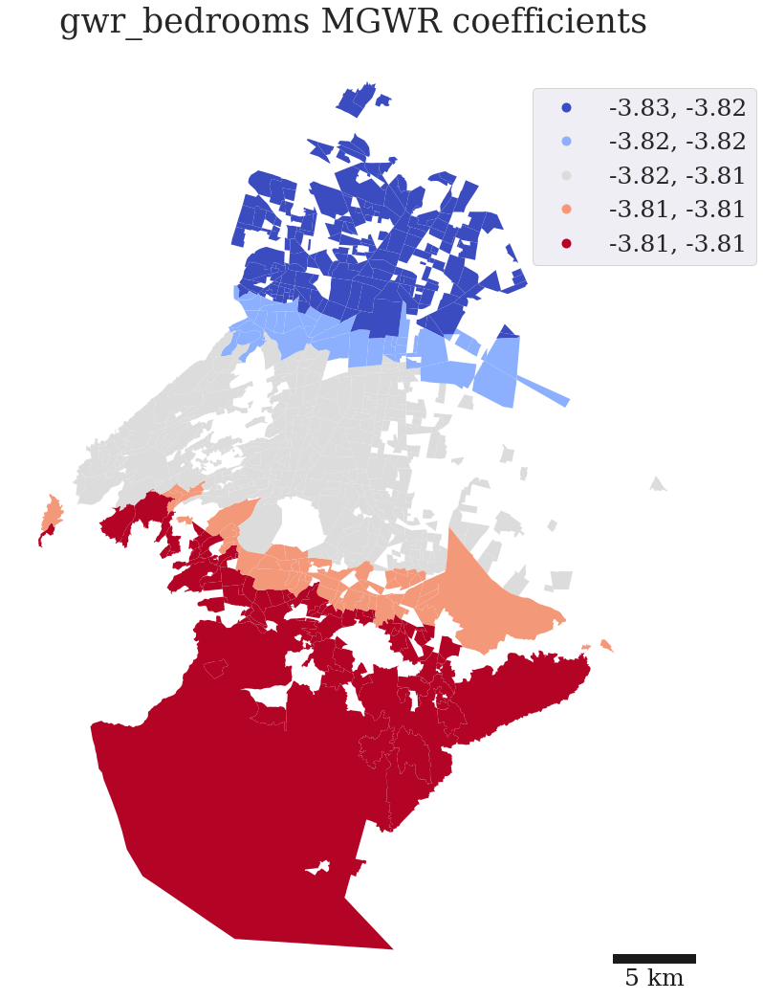

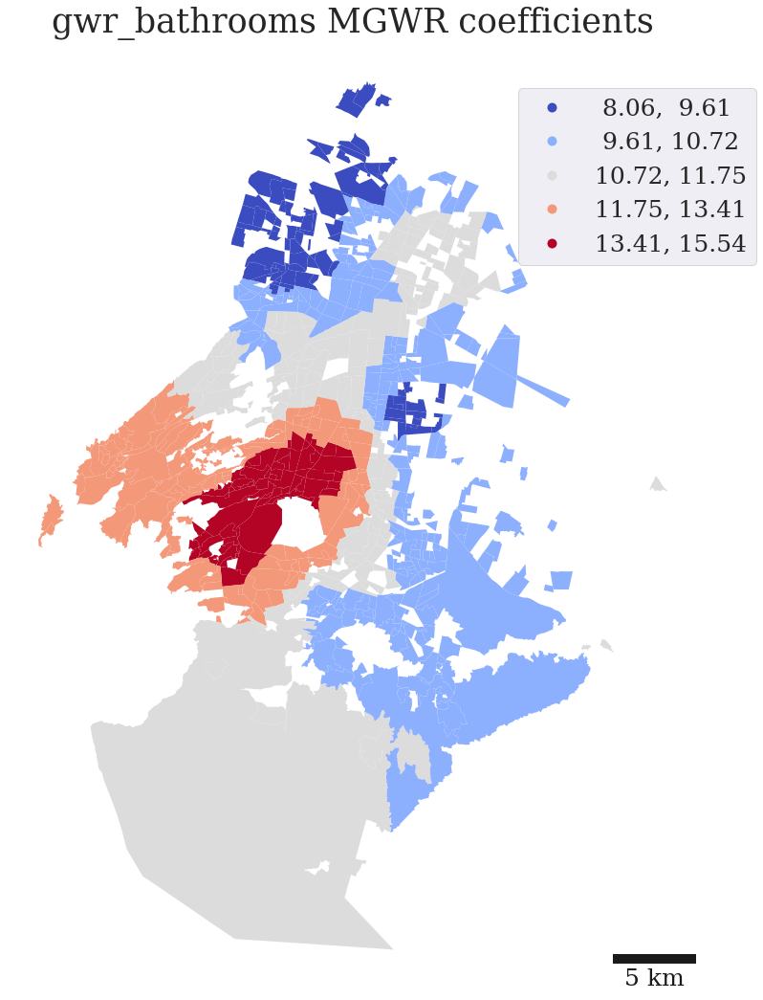

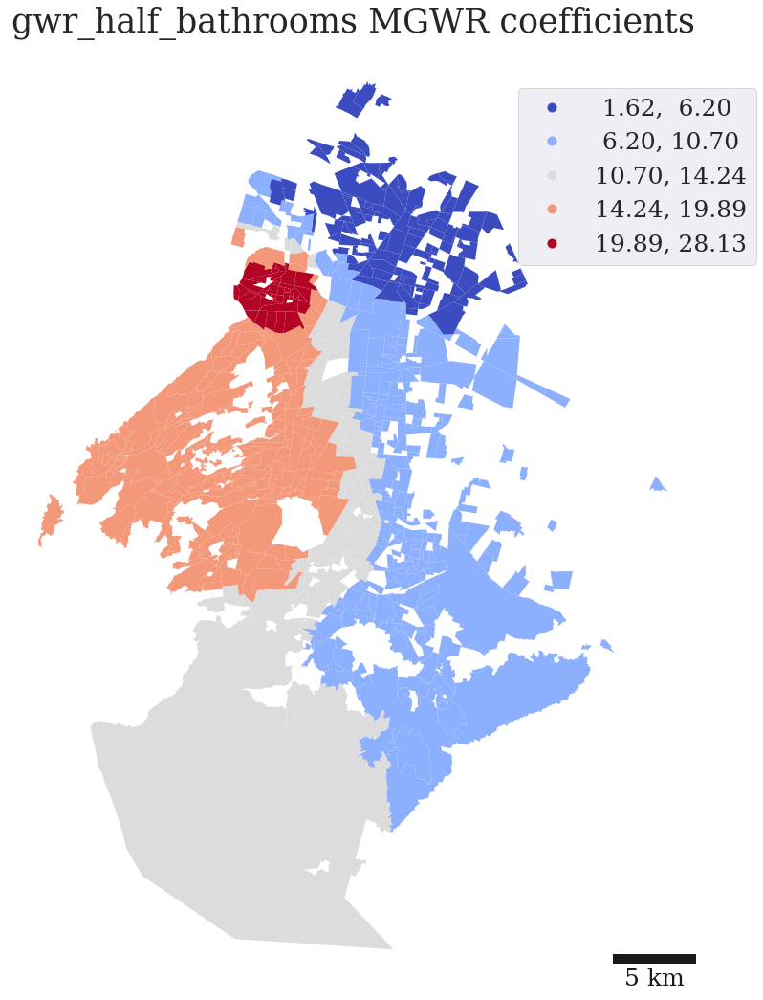

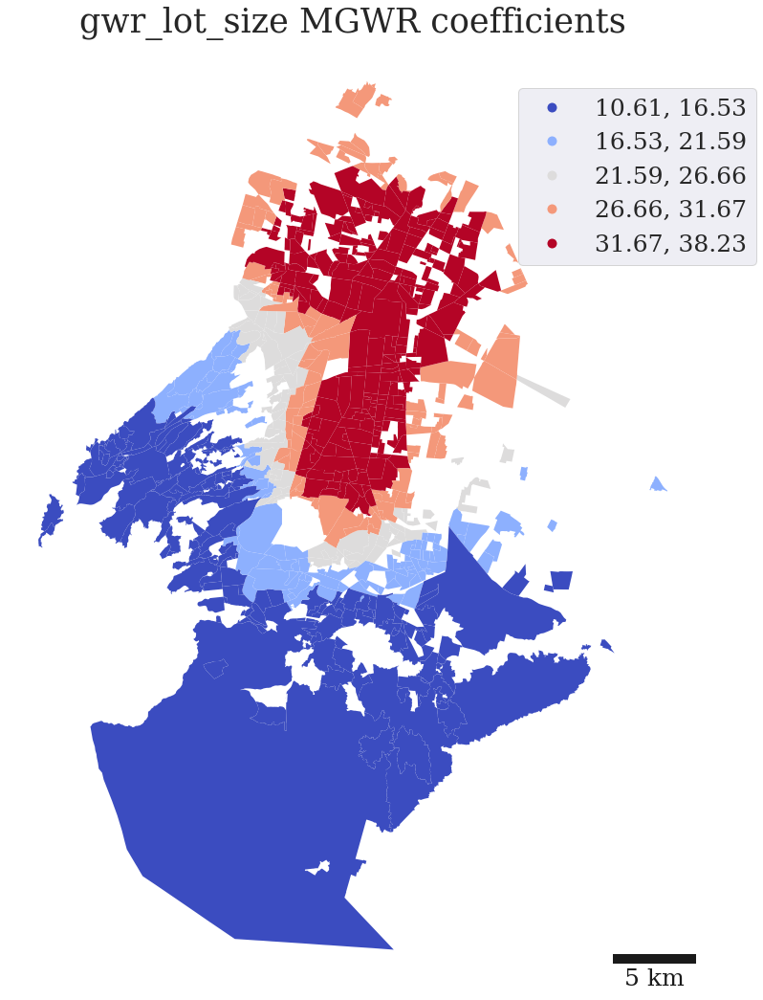

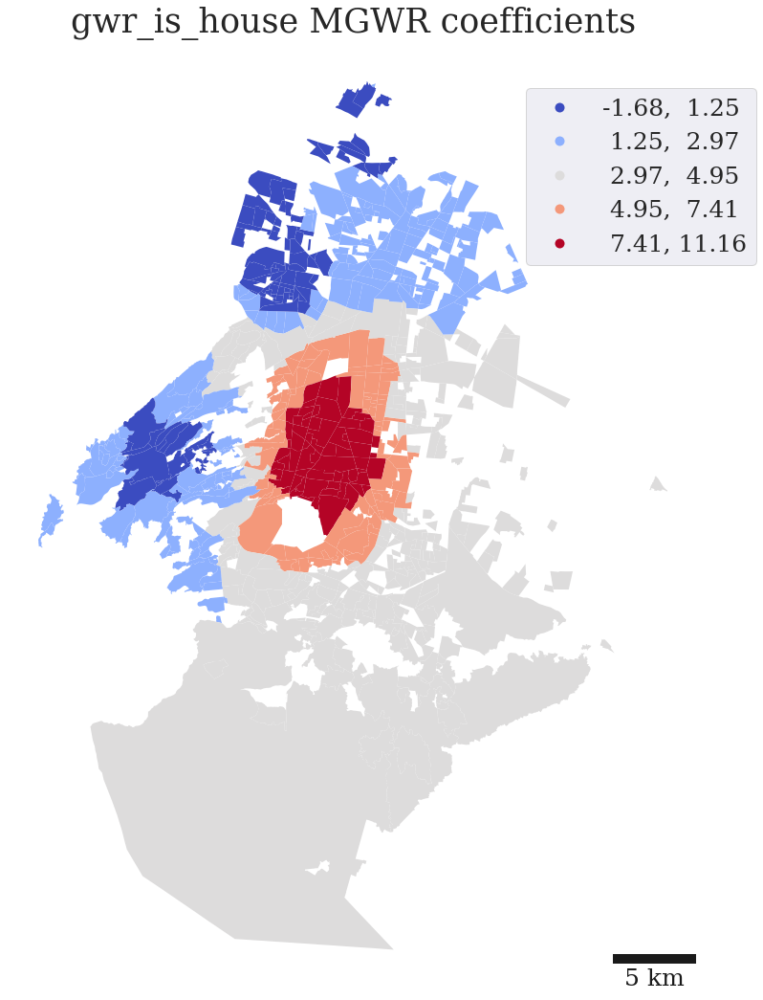

...

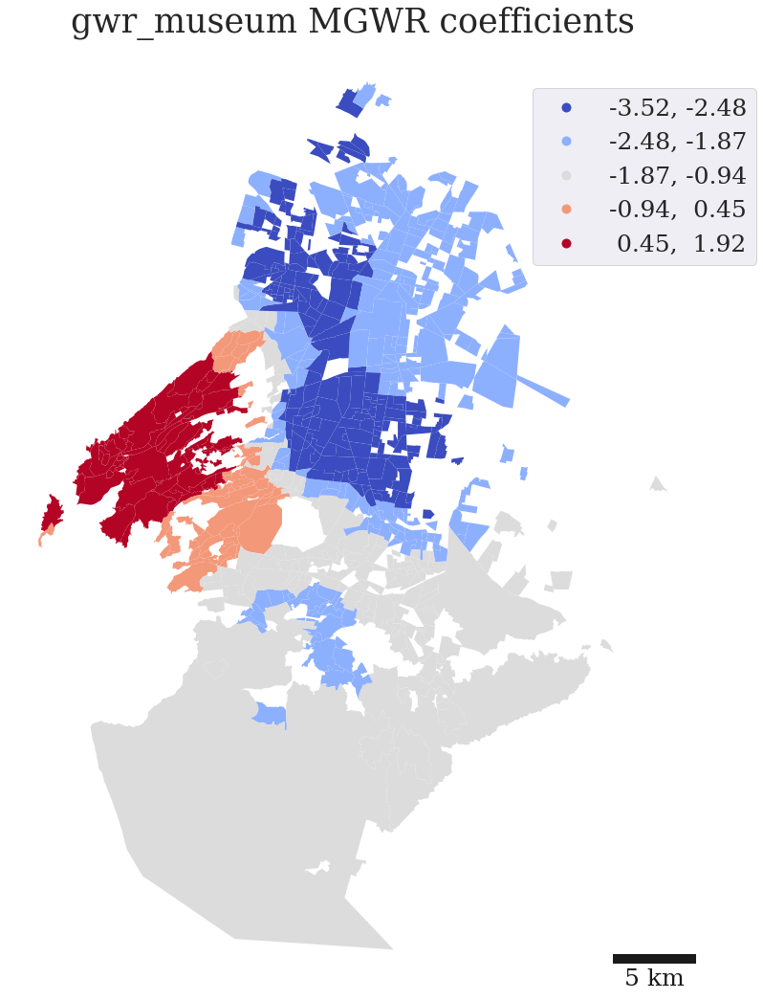

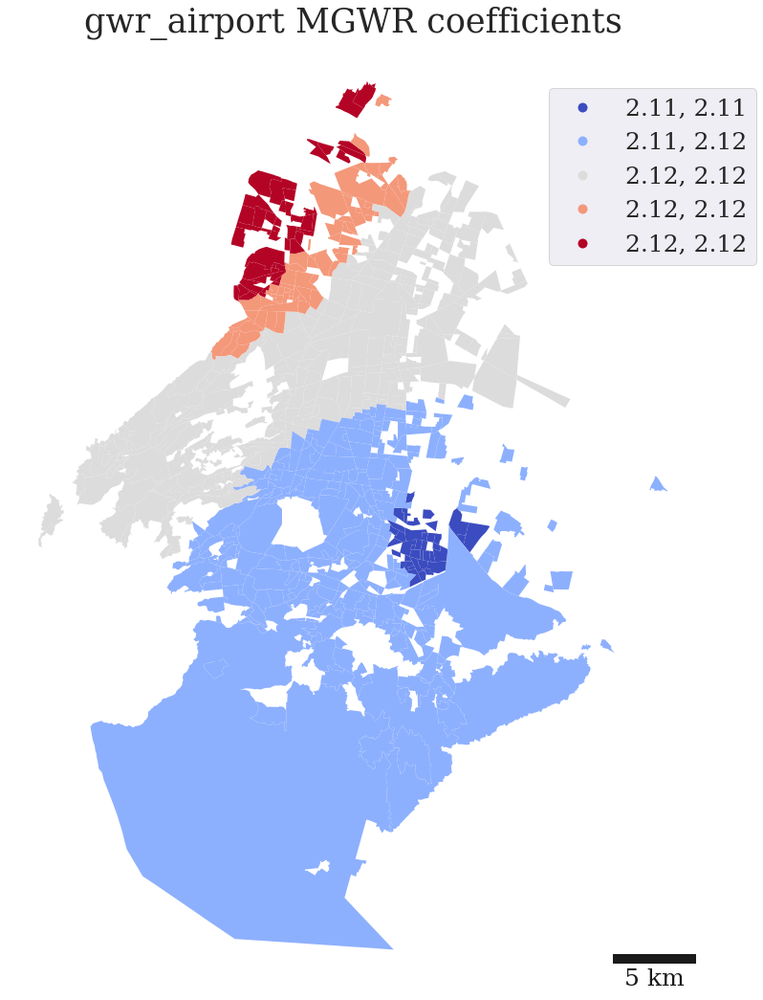

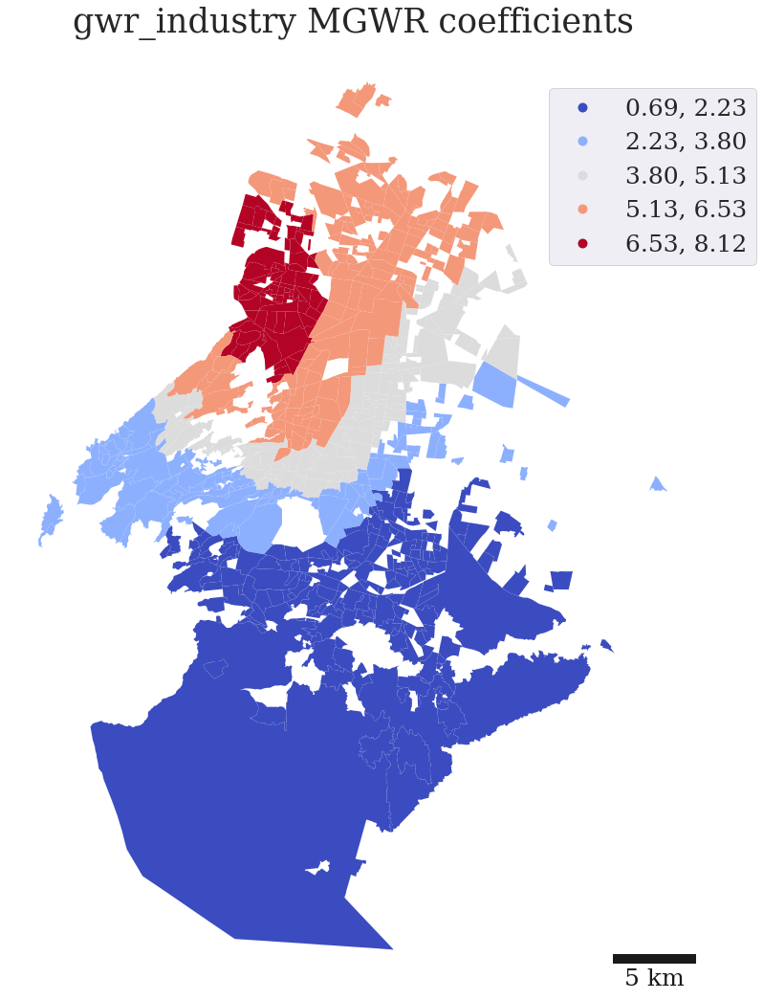

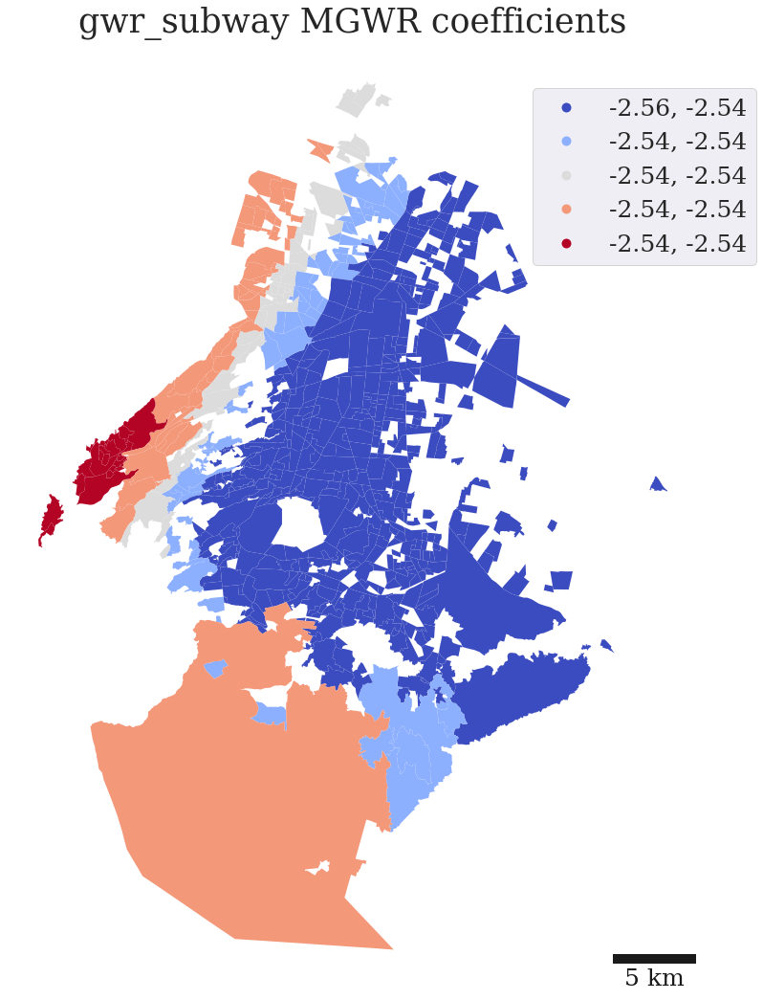

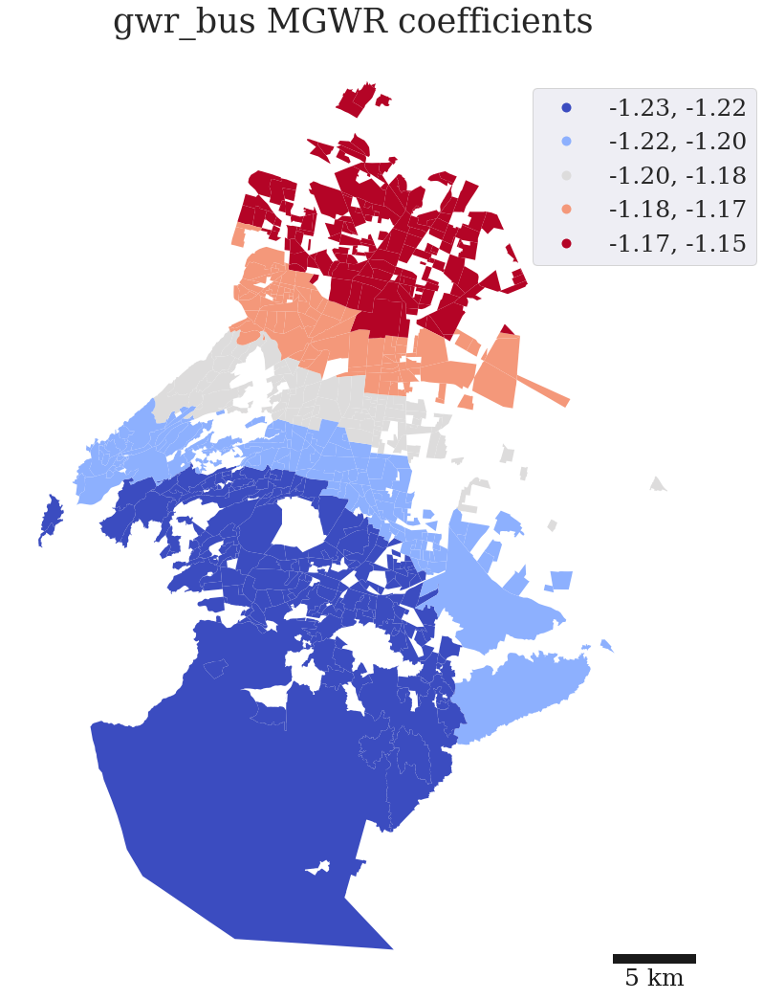

In [81]:
for num,col in enumerate (coef_names):

    try:
       
        fig, ax = plt.subplots(figsize=(18, 18))
        gdf_mr.plot(column=col, cmap = 'coolwarm', linewidth=0.01, scheme = 'FisherJenks', k=5, legend=True, legend_kwds={'bbox_to_anchor':(1.10, 0.96), 'fontsize': 25},  ax=ax)
        ax.set_title(col +  ' MGWR coefficients',     fontsize=35)
        ax.axis("off")
        #plt.savefig('myMap.png',dpi=150, bbox_inches='tight')
        scalebar = ScaleBar(1, location='lower right', box_alpha=0.7, font_properties={'size': 25})
        ax.add_artist(scalebar)

        
        
        #fig.savefig("img/" + col+' MGWR.png', dpi=300)
        
        plt.show()

    except:
        pass